In [1]:
import pandas as pd

In [2]:
# LOAD dataset
cfd_df = pd.read_csv("apollo_cfd_database.csv")

# RENAME columns with corresponding names
new_col_names = {
    "X":"x",
    "Y":"y",
    "Z":"z",
    "pw (Pa)":"pressure",
    "qw (W/m^2)":"heat_flux",
    "Me": "edge_mach_number",
    "delta (m)": "boundary_layer_thickness",
    "theta (m)": "momentum_thickness",
    "Re-theta": "momentum_thickness_reynolds_number",
    "tauw (Pa)": "shear_stress",
    "mach (-)": "mach",
    "velocity (m/s)":"velocity",
    "density (kg/m^3)": "density",
    "aoa (degrees)": "angle_of_attack",
    "dynamic_pressure (Pa)":"dynamic_pressure"
    }
cfd_df.rename(columns=new_col_names, inplace=True)
cfd_df.head()

,x,y,z,pressure,heat_flux,edge_mach_number,boundary_layer_thickness,momentum_thickness,momentum_thickness_reynolds_number,shear_stress,mach,velocity,density,angle_of_attack,dynamic_pressure
0,0.017768,0.003489,-0.407755,64489.349983,497625.036467,0.454910,0.006833,0.000982,188.672182,39.628433,14.16745,4500.0,0.003851,154.0,38991.469837
1,0.018617,0.007022,-0.417330,64611.153940,498418.814300,0.451899,0.006820,0.000980,187.407496,39.410061,14.16745,4500.0,0.003851,154.0,38991.469837
2,0.015687,0.003484,-0.383248,64163.104160,495351.845000,0.462855,0.006867,0.000986,192.028006,40.138121,14.16745,4500.0,0.003851,154.0,38991.469837
3,0.016301,0.006972,-0.390625,64263.850973,496055.340900,0.460389,0.006857,0.000985,190.994027,39.990073,14.16745,4500.0,0.003851,154.0,38991.469837
4,0.014133,0.003485,-0.363827,63903.617037,493426.773433,0.469249,0.006893,0.000989,194.737028,40.464771,14.16745,4500.0,0.003851,154.0,38991.469837


In [3]:
# DEFINE independent and dependent variables
ind_var = ["velocity", "density", "angle_of_attack", "mach", "dynamic_pressure"]
dep_var = "heat_flux"

In [4]:
# FILTER independent and dependent from entire dataframe
filtered_df = cfd_df[ind_var + [dep_var]]

In [5]:
# GROUP by independent variables IMPORTANT!!!: There should be 185 rows
# grouped = (
#     filtered_df.groupby(ind_var)[dep_var]
#       .apply(lambda x: x.values)
#       .reset_index()
# )
skip = 50176
shield_dfs = [filtered_df.iloc[start:start+skip].reset_index(drop=True) for start in range(0, len(filtered_df), skip)]
shield_dfs[0]

,velocity,density,angle_of_attack,mach,dynamic_pressure,heat_flux
0,4500.0,0.003851,154.0,14.16745,38991.469837,497625.036467
1,4500.0,0.003851,154.0,14.16745,38991.469837,498418.814300
2,4500.0,0.003851,154.0,14.16745,38991.469837,495351.845000
3,4500.0,0.003851,154.0,14.16745,38991.469837,496055.340900
4,4500.0,0.003851,154.0,14.16745,38991.469837,493426.773433
...,...,...,...,...,...,...
50171,4500.0,0.003851,154.0,14.16745,38991.469837,162163.484333
50172,4500.0,0.003851,154.0,14.16745,38991.469837,147032.652667
50173,4500.0,0.003851,154.0,14.16745,38991.469837,151146.819333
50174,4500.0,0.003851,154.0,14.16745,38991.469837,138349.241300


In [6]:
grouped_dfs = []
for shield_df in shield_dfs:
    shield_grouped = (
        shield_df.groupby(ind_var, sort=False, as_index=False)
        .agg({dep_var: list})
    )
    grouped_dfs.append(shield_grouped)

In [7]:
grouped = pd.concat(grouped_dfs, ignore_index=True)
grouped

,velocity,density,angle_of_attack,mach,dynamic_pressure,heat_flux
0,4500.0,0.003851,154.0,14.167450,38991.469837,"[497625.0364666667, 498418.8143, 495351.845, 4..."
1,10500.0,0.000149,152.0,34.428650,8232.467608,"[1372325.614, 1374695.721, 1365632.0713333336,..."
2,9000.0,0.000978,152.0,27.289638,39589.765294,"[2160698.7363333334, 2164429.8673333335, 21498..."
3,4500.0,0.001881,152.0,13.788210,19048.054327,"[350905.1739333333, 351507.0865666666, 349191...."
4,9500.0,0.000537,152.0,29.420906,24217.868842,"[1904901.7646666665, 1908184.924, 1895399.1, 1..."
...,...,...,...,...,...,...
180,6500.0,0.000149,156.0,21.312974,3154.845864,"[338552.6296666667, 339051.752, 337166.5758, 3..."
181,5500.0,0.000978,152.0,16.677001,14785.066669,"[486239.4619666666, 487090.11546666664, 483849..."
182,8500.0,0.000288,152.0,27.064293,10415.591115,"[1007372.032, 1009196.2343333334, 1002276.111,..."
183,9500.0,0.000537,154.0,29.420906,24217.868842,"[1932085.2633333337, 1935239.4893333337, 19230..."


In [8]:
# DEFINE Pytorch dataset
import numpy as np
import torch

class CFDSolutions(torch.utils.data.Dataset):
    def __init__(self, grouped_df):
        self.X = grouped_df[ind_var].values.astype('float32')
        self.Y = np.stack(grouped_df[dep_var].values).astype('float32')

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return torch.from_numpy(self.X[idx]), torch.from_numpy(self.Y[idx])

In [9]:
# INITIALIZE dataset with Grouped data
dataset = CFDSolutions(grouped)

In [10]:
# TEST dataset, tensor X = [number of dependent variables], tensor Y = [50176 independent variables]
dataset[0]

(tensor([4.5000e+03, 3.8510e-03, 1.5400e+02, 1.4167e+01, 3.8991e+04]),
 tensor([497625.0312, 498418.8125, 495351.8438,  ..., 151146.8125,
         138349.2344, 140711.0000]))

In [ ]:
# DEFINE model arquitecture
class ShieldModel(torch.nn.Module):
    def __init__(self):
        super(ShieldModel, self).__init__()
        self.linear1 = torch.nn.Linear(in_features = len(ind_var), out_features = 256)
        self.linear2 = torch.nn.Linear(in_features = 256, out_features = 512)
        self.linear3 = torch.nn.Linear(in_features = 512, out_features = 1024)
        self.linear4 = torch.nn.Linear(in_features = 1024, out_features = 50176)

    def forward(self, x):
        x = self.linear1(x)
        x = torch.nn.functional.gelu(x)

        x = self.linear2(x)
        x = torch.nn.functional.gelu(x)

        x = self.linear3(x)
        x = torch.nn.functional.gelu(x)

        x = self.linear4(x)
        return x 

In [126]:
# TEST model
dummy_batch = torch.zeros(10, len(ind_var))
my_model = ShieldModel()
predictions = my_model(dummy_batch)
print(dummy_batch.shape, predictions.shape)

torch.Size([10, 5]) torch.Size([10, 50176])


In [127]:
# DEFINE training loop
from torch.utils.data import DataLoader
import torch.optim as optim
from livelossplot import PlotLosses

def train_model(n_epochs, threshold, model, loss_fn, optimizer, scheduler, train_loader, val_loader, device):
    # for gpu training
    model = model.to(device)
    loss_fn = loss_fn.to(device)
    # for plotting
    liveloss = PlotLosses()
    for epoch in range(n_epochs):
        logs = {}
        # initialize control variables.
        correct = 0
        cumulative_loss = 0
        n_samples = 0
        # Set the model in training mode.
        model.train()
        for idx_batch, (X, y) in enumerate(train_loader):
            model.zero_grad()
            # Move (x,y) data to GPU (if so desired).
            X = X.to(device)
            y = y.to(device)
            # Compute predictions.
            pred = model(X)
            # Compute loss.
            loss = loss_fn(pred, y)
            cumulative_loss += loss.item()
            # Count how many correct in batch.
            pred_placeholder = pred.detach()
            percent_diff_each = (pred_placeholder - y).abs() / y.abs() * 100
            mean_percent_diff = percent_diff_each.mean(dim=1)
            mask = mean_percent_diff < threshold
            correct += mask.sum().cpu().item()
            n_samples += mask.size(0)
            # Compute gradients (autograd).
            loss.backward()
            # Run one basic training step of SGD.
            optimizer.step()
            # Keep track of loss and accuracy for the plot.
            n_batches = 1 + idx_batch
            logs['loss'] = cumulative_loss / n_batches
            logs['accuracy'] = correct / n_samples
        # initialize control variables.
        correct = 0
        cumulative_loss = 0
        n_samples = 0
        # Set the model in evaluation mode.
        model.eval()
        with torch.no_grad():
            for idx_batch, (X, y) in enumerate(val_loader):
                # Move data to GPU if needed.
                X = X.to(device)
                y = y.to(device)
                # Compute predictions.
                pred = model(X)
                # Compute loss.
                loss = loss_fn(pred, y)
                cumulative_loss += loss.item()
                # Count how many correct in batch.
                pred_placeholder = pred.detach()
                percent_diff_each = (pred_placeholder - y).abs() / y.abs() * 100
                mean_percent_diff = percent_diff_each.mean(dim=1)
                mask = mean_percent_diff < threshold
                correct += mask.sum().cpu().item()
                n_samples += mask.size(0)
                # Keep track of loss and accuracy for the plot.
                n_batches = 1 + idx_batch
                logs['val_loss'] = cumulative_loss / n_batches
                logs['val_accuracy'] = correct / n_samples
        # Update the plot with new logging information.
        liveloss.update(logs)
        liveloss.send()

        if scheduler != -1:
            scheduler.step()

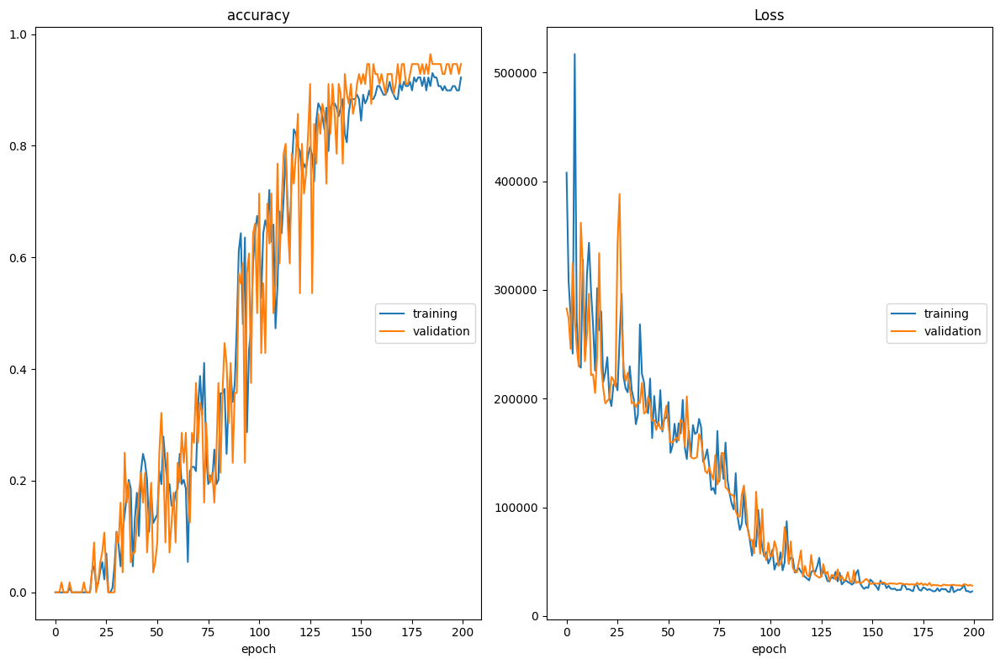

accuracy
	training         	 (min:    0.000, max:    0.930, cur:    0.922)
	validation       	 (min:    0.000, max:    0.964, cur:    0.946)
Loss
	training         	 (min: 21737.786, max: 516935.354, cur: 22587.105)
	validation       	 (min: 27650.338, max: 388178.500, cur: 27797.687)


In [128]:
# DEFINE training parameters
from sklearn.model_selection import train_test_split
from torch.optim import lr_scheduler

train_df, val_df = train_test_split(grouped, test_size=0.30, random_state=42)

n_epochs = 200
batch_size = 16
lr = 0.01
threshold = 10

train_set = CFDSolutions(train_df)
val_set = CFDSolutions(val_df)

train_loader = DataLoader(train_set, batch_size, shuffle=True)
val_loader = DataLoader(val_set, batch_size, shuffle=False)

model = ShieldModel()
loss_fn = torch.nn.SmoothL1Loss()
optimizer = optim.AdamW(model.parameters(), lr, weight_decay=1e-4)
device = torch.device("mps")
scheduler = lr_scheduler.StepLR(optimizer, step_size=30, gamma=0.5)

train_model(n_epochs, threshold, model, loss_fn, optimizer, scheduler, train_loader, val_loader, device)

In [253]:
# SAMPLE 1 of 185 point for testing
idx_sample = 1
x_sample = grouped.loc[idx_sample, ind_var].to_numpy(dtype='float32')
y_sample = grouped.loc[idx_sample, dep_var]
x_sample_tensor = torch.tensor([x_sample], dtype=torch.float32).to(device)

In [254]:
# TEST 1 sample with model
model.eval()
with torch.no_grad():
    prediction = model(x_sample_tensor).squeeze(0).cpu().numpy()
print(prediction)
print(y_sample)

[1356877.5  1358379.8  1350044.9  ...  330608.62  300693.6   306471.03]
[1372325.614, 1374695.721, 1365632.0713333336, 1367675.5710000002, 1359897.4606666665, 1361638.774, 1355082.1843333335, 1356521.0806666666, 1351056.873, 1352255.163333333, 1347617.8313333334, 1348644.0140000002, 1344579.2536666666, 1345489.709, 1341797.5259999998, 1342633.7193333332, 1339176.055333333, 1339963.842, 1336653.3673333337, 1337409.266, 1334170.2523333337, 1334914.5646666668, 1331636.312, 1332403.596, 1328917.542666667, 1329758.275666667, 1325910.2076666665, 1326852.3896666667, 1322731.2866666669, 1323701.8236666666, 1319442.877, 1320446.4163333334, 1315963.9526666666, 1317040.751, 1312363.1679999998, 1313463.9143333333, 1308730.4393333334, 1309839.7373333334, 1305098.282, 1306209.551, 1301481.5896666667, 1302591.51, 1297886.159, 1298993.9636666663, 1294309.7306666663, 1295417.014, 1290743.702, 1291853.785, 1287182.853, 1288296.339, 1283622.322, 1284740.88, 1280054.8856666666, 1281180.8626666667, 1276474

In [255]:
print(type(np.array(y_sample)))

<class 'numpy.ndarray'>


In [256]:
percent_diff_each = np.abs(prediction - np.array(y_sample)) / np.abs(np.array(y_sample)) * 100
mean_percent_diff = percent_diff_each.mean()
mean_percent_diff

4.0273081147419045

In [257]:
# COLLECT coordiantes for ploting
xyz_df = cfd_df[["x", "y", "z"]].iloc[0:50176]

In [258]:
# ATTACH correct and prediction
xyz_df["correct"] = y_sample
xyz_df["prediction"] = prediction
xyz_df["percent_difference"] = np.abs(prediction - np.array(y_sample)) / np.abs(np.array(y_sample)) * 100

In [259]:
xyz_df

,x,y,z,correct,prediction,percent_difference
0,0.017768,0.003489,-0.407755,1.372326e+06,1.356878e+06,1.125689
1,0.018617,0.007022,-0.417330,1.374696e+06,1.358380e+06,1.186879
2,0.015687,0.003484,-0.383248,1.365632e+06,1.350045e+06,1.141391
3,0.016301,0.006972,-0.390625,1.367676e+06,1.352434e+06,1.114414
4,0.014133,0.003485,-0.363827,1.359897e+06,1.344633e+06,1.122481
...,...,...,...,...,...,...
50171,0.649148,0.015809,-1.931491,4.635066e+05,3.567261e+05,23.037544
50172,0.655325,0.031553,-1.927749,4.195435e+05,3.204921e+05,23.609322
50173,0.653792,0.015788,-1.928851,4.310747e+05,3.306086e+05,23.305961
50174,0.659870,0.031508,-1.924942,3.957806e+05,3.006936e+05,24.025174


In [260]:
# PLOT correct points
import plotly.express as px

fig = px.scatter_3d(
    xyz_df,
    x="x",
    y="y",
    z="z",
    color="correct",
    color_continuous_scale="Viridis" ,
    hover_data=xyz_df.columns
)

fig.show()

In [261]:
# PLOT predicted points
fig = px.scatter_3d(
    xyz_df,
    x="x",
    y="y",
    z="z",
    color="prediction",
    color_continuous_scale="Viridis" ,
    hover_data=xyz_df.columns
)

fig.show()

In [263]:
# PLOT diffrence points
fig = px.scatter_3d(
    xyz_df,
    x="x",
    y="y",
    z="z",
    color="percent_difference",
    color_continuous_scale="Viridis" ,
    range_color=[1, 100],
    hover_data=xyz_df.columns
)

fig.show()